cars: 8792 not_cars: 8968


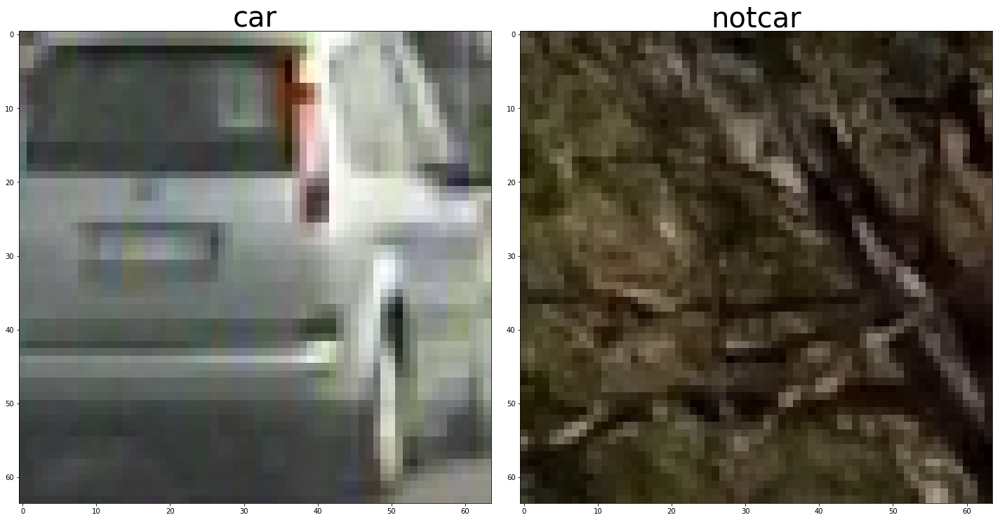

In [2]:
############################################
# 1. LOADING THE DATASET
############################################

import matplotlib.image as mpimg
import matplotlib.pyplot as plt
import math
import numpy as np
import cv2
import glob
from skimage.feature import hog

%matplotlib inline
#from skimage.feature import hog
#from skimage import color, exposure
# images are divided up into vehicles and non-vehicles

cars = glob.glob('dataset/vehicles/**/*.png', recursive=True)
notcars = glob.glob('dataset/non-vehicles/**/*.png', recursive=True)

        
print("cars: {} not_cars: {}".format(len(cars), len(notcars)))

#plots images in a grid. imgs = [{'img':ndarray, 'title':'img title'}, ... ]
def plots(imgs, colw=2):
    imgcount = len(imgs)
    rows = int(math.ceil(imgcount/colw))
    f, axes = plt.subplots(rows, colw,  figsize=(10*colw,10*rows), squeeze=False)
    f.tight_layout()
    
    for i in range(imgcount):
        img = imgs[i]['img']
        cmap = 'gray' if len(img.shape)==2 or (len(img.shape)==3 and img.shape[2]==1) else None
        axes[i//colw][i%colw].imshow(img, cmap=cmap)
        axes[i//colw][i%colw].set_title(imgs[i]['title'], fontsize=40)

car_ind = np.random.randint(0, len(cars))
notcar_ind = np.random.randint(0, len(notcars))

plots([{'img':mpimg.imread(cars[car_ind]), 'title':'car'}, 
       {'img':mpimg.imread(notcars[notcar_ind]), 'title':'notcar'} ])
        


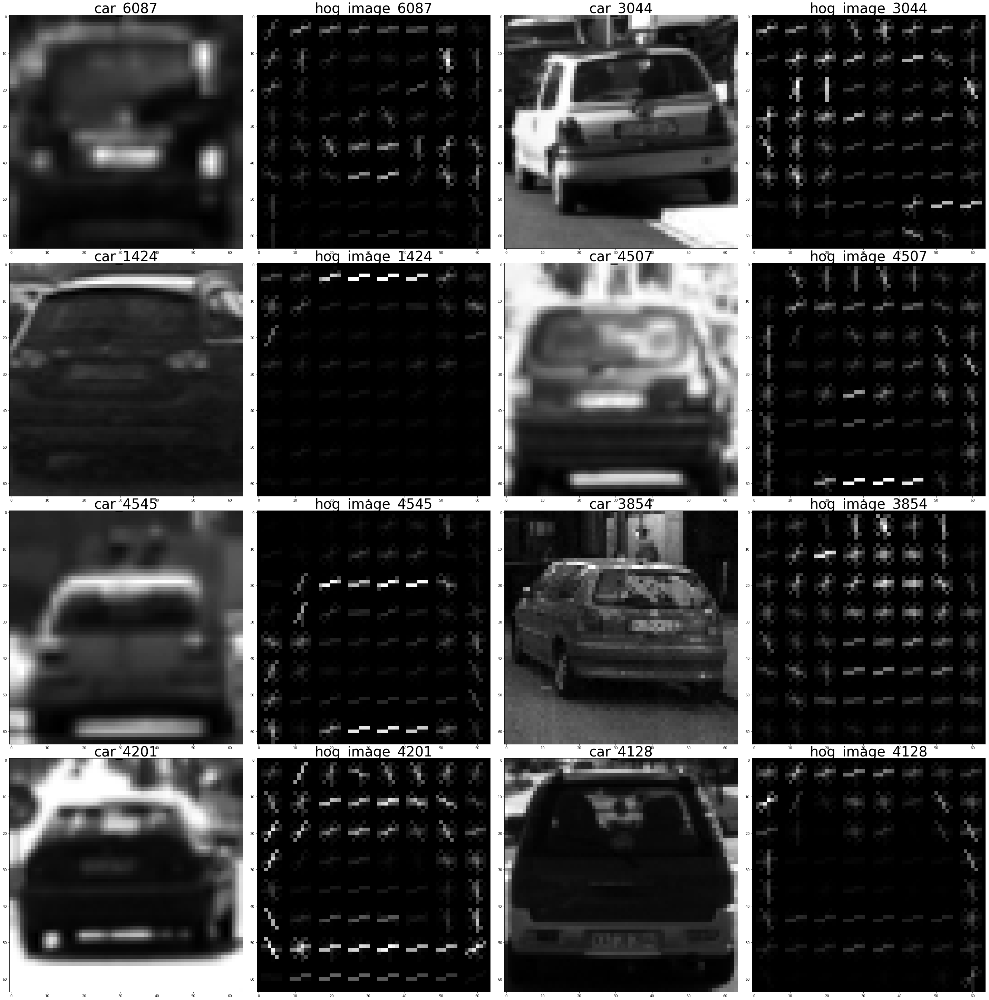

In [3]:
############################################
# 2. HOG FEATURES EXPLORATION
############################################# 
#Define a function to return HOG features and visualization
from skimage.feature import hog

def get_hog_features(img, orient, pix_per_cell, cell_per_block, vis=False, feature_vec=True):
    if vis == True:
        features, hog_image = hog(img, orientations=orient, pixels_per_cell=(pix_per_cell, pix_per_cell),
                                  cells_per_block=(cell_per_block, cell_per_block), transform_sqrt=False, 
                                  visualise=True, feature_vector=feature_vec)
        return features, hog_image
    else:      
        features = hog(img, orientations=orient, pixels_per_cell=(pix_per_cell, pix_per_cell),
                       cells_per_block=(cell_per_block, cell_per_block), transform_sqrt=False, 
                       visualise=False, feature_vector=feature_vec)
        return features



# Define HOG parameters
orient = 9
pix_per_cell = 8
cell_per_block = 2




imgs = []
for i in range(8):
    i = {}
    ind = np.random.randint(0, len(cars))
    image = mpimg.imread(cars[ind])
    gray = cv2.cvtColor(image, cv2.COLOR_RGB2YCrCb)[:,:,0]
    i['img'] = gray
    i['title'] = "car_" + str(ind)
    imgs.append(i)
    
    features, hog_image = get_hog_features(gray, orient,  pix_per_cell, cell_per_block, vis=True, feature_vec=False)
    #print(features.shape)
    i = {}
    i['img'] = hog_image
    i['title'] = "hog_image_" + str(ind)
    imgs.append(i)
    
plots(imgs, colw=4)





8792 8968
(17760, 8460) (17760, 8460)


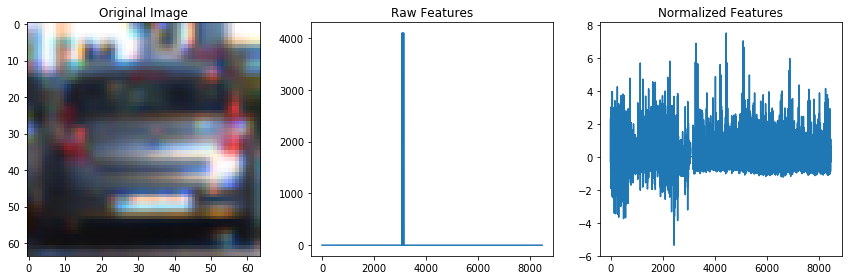

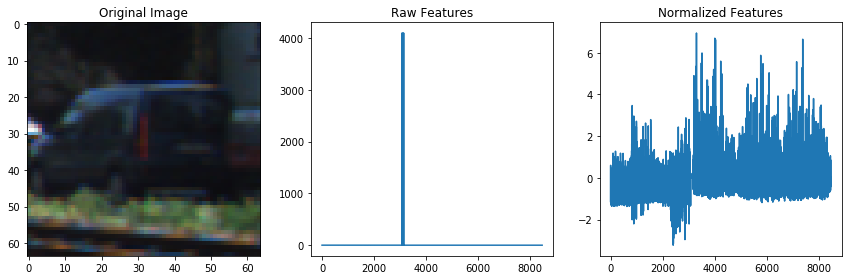

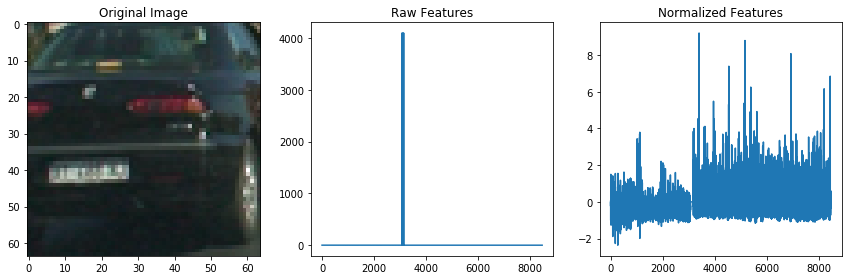

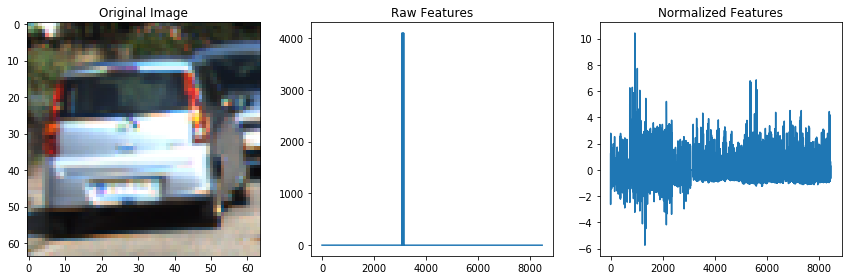

In [4]:
########################################################
# 3. SPATIAL BINNING AND HISTOGRAM FEATURES EXPLORATION
########################################################
from sklearn.preprocessing import StandardScaler

def bin_spatial(img, color_space='RGB', size=(32, 32)):
    # Convert image to new color space (if specified)
    if color_space != 'RGB':
        if color_space == 'HSV':
            feature_image = cv2.cvtColor(img, cv2.COLOR_RGB2HSV)
        elif color_space == 'LUV':
            feature_image = cv2.cvtColor(img, cv2.COLOR_RGB2LUV)
        elif color_space == 'HLS':
            feature_image = cv2.cvtColor(img, cv2.COLOR_RGB2HLS)
        elif color_space == 'YUV':
            feature_image = cv2.cvtColor(img, cv2.COLOR_RGB2YUV)
        elif color_space == 'YCrCb':
            feature_image = cv2.cvtColor(img, cv2.COLOR_RGB2YCrCb)
    else: feature_image = np.copy(img)             
    # Use cv2.resize().ravel() to create the feature vector
    features = cv2.resize(feature_image, size).ravel() 
    # Return the feature vector
    return features

# Define a function to compute color histogram features  
def color_hist(img, nbins=32, bins_range=(0, 256)):
    # Compute the histogram of the color channels separately
    channel1_hist = np.histogram(img[:,:,0], bins=nbins, range=bins_range)
    channel2_hist = np.histogram(img[:,:,1], bins=nbins, range=bins_range)
    channel3_hist = np.histogram(img[:,:,2], bins=nbins, range=bins_range)
    # Concatenate the histograms into a single feature vector
    hist_features = np.concatenate((channel1_hist[0], channel2_hist[0], channel3_hist[0]))
    # Return the individual histograms, bin_centers and feature vector
    return hist_features


# Define a function to extract features from a single image window
# This function is very similar to extract_features()
# just for a single image rather than list of images
def extract_block_features(img, color_space='RGB', spatial_size=(32, 32),
                        hist_bins=32, orient=9, 
                        pix_per_cell=8, cell_per_block=2, hog_channel=0,
                        spatial_feat=True, hist_feat=True, hog_feat=True, **kwargs ):    
    #1) Define an empty list to receive features
    img_features = []
    #2) Apply color conversion if other than 'RGB'
    if color_space != 'RGB':
        if color_space == 'HSV':
            feature_image = cv2.cvtColor(img, cv2.COLOR_RGB2HSV)
        elif color_space == 'LUV':
            feature_image = cv2.cvtColor(img, cv2.COLOR_RGB2LUV)
        elif color_space == 'HLS':
            feature_image = cv2.cvtColor(img, cv2.COLOR_RGB2HLS)
        elif color_space == 'YUV':
            feature_image = cv2.cvtColor(img, cv2.COLOR_RGB2YUV)
        elif color_space == 'YCrCb':
            feature_image = cv2.cvtColor(img, cv2.COLOR_RGB2YCrCb)
    else: feature_image = np.copy(img)      
    #3) Compute spatial features if flag is set
    if spatial_feat == True:
        spatial_features = bin_spatial(feature_image, size=spatial_size)
        #4) Append features to list
        img_features.append(spatial_features)
    #5) Compute histogram features if flag is set
    if hist_feat == True:
        hist_features = color_hist(feature_image, nbins=hist_bins)
        #6) Append features to list
        img_features.append(hist_features)
    #7) Compute HOG features if flag is set
    if hog_feat == True:
        if hog_channel == 'ALL':
            hog_features = []
            for channel in range(feature_image.shape[2]):
                hog_features.extend(get_hog_features(feature_image[:,:,channel], 
                                    orient, pix_per_cell, cell_per_block, 
                                    vis=False, feature_vec=True))      
        else:
            hog_features = get_hog_features(feature_image[:,:,hog_channel], orient, 
                        pix_per_cell, cell_per_block, vis=False, feature_vec=True)
        #8) Append features to list
        img_features.append(hog_features)

    #9) Return concatenated array of features
    return np.concatenate(img_features)


feat_pars = {
    'color_space' : 'YCrCb', # Can be RGB, HSV, LUV, HLS, YUV, YCrCb
    'orient' : 9,  # HOG orientations
    'pix_per_cell' : 8, # HOG pixels per cell
    'cell_per_block' : 2, # HOG cells per block
    'hog_channel' : 'ALL', # Can be 0, 1, 2, or "ALL"
    'spatial_size' : (32, 32), # Spatial binning dimensions
    'hist_bins' : 32,    # Number of histogram bins
    'spatial_feat' : True, # Spatial features on or off
    'hist_feat' : True, # Histogram features on or off
    'hist_range' : (0,256), #hist range
    'hog_feat' : True # HOG features on or off
}



def extract_features(imgfiles, **kwargs ):
    features = []
    for imgfile in imgfiles:
        img = mpimg.imread(imgfile)
        features.append(extract_block_features(img, **kwargs ))
    return features

        
car_features = extract_features(cars, **feat_pars)
notcar_features = extract_features(notcars, **feat_pars)

#display features of random car

print(len(car_features), len(notcar_features))

X = np.vstack((car_features, notcar_features)).astype(np.float64)                        
# Fit a per-column scaler
X_scaler = StandardScaler().fit(X)
# Apply the scaler to X
scaled_X = X_scaler.transform(X)

print( scaled_X.shape, X.shape )

def display_random_features(n=1):
    for i in range(n):
        # Plot an example of raw and scaled features
        car_ind = np.random.randint(0, len(car_features))
        fig = plt.figure(figsize=(12,4))
        plt.subplot(131)
        plt.imshow(mpimg.imread(cars[car_ind]))
        plt.title('Original Image')
        plt.subplot(132)
        plt.plot(X[car_ind])
        plt.title('Raw Features')
        plt.subplot(133)
        plt.plot(scaled_X[car_ind])
        plt.title('Normalized Features')
        fig.tight_layout()

display_random_features(4)
    


In [5]:
########################################################
# 4. TRAINING THE CLASSIFIER
########################################################
import time
from sklearn.svm import LinearSVC
from sklearn.cross_validation import train_test_split

def TrainClassifier(**kwargs):
    # Define the labels vector
    y = np.hstack((np.ones(len(car_features)), np.zeros(len(notcar_features))))

    # Split up data into randomized training and test sets
    X_train, X_test, y_train, y_test = train_test_split( scaled_X, y, test_size=0.2, random_state=np.random.randint(0, 100) )

    print('Using:', kwargs )
    print('Feature vector length:', len(X_train[0]))
    # Use a linear SVC 
    svc = LinearSVC()
    # Check the training time for the SVC
    t=time.time()
    svc.fit(X_train, y_train)
    t2 = time.time()
    print(round(t2-t, 2), 'Seconds to train SVC...')
    # Check the score of the SVC
    print('Test Accuracy of SVC = ', round(svc.score(X_test, y_test), 4))
    # Check the prediction time for a single sample
    t=time.time()
    
    return svc

svc = TrainClassifier(**feat_pars)

/Users/alberto/miniconda3/envs/carnd-term1/lib/python3.5/site-packages/sklearn/cross_validation.py:44: DeprecationWarning: This module was deprecated in version 0.18 in favor of the model_selection module into which all the refactored classes and functions are moved. Also note that the interface of the new CV iterators are different from that of this module. This module will be removed in 0.20.
  "This module will be removed in 0.20.", DeprecationWarning)


Using: {'orient': 9, 'spatial_feat': True, 'spatial_size': (32, 32), 'hog_channel': 'ALL', 'cell_per_block': 2, 'hist_range': (0, 256), 'pix_per_cell': 8, 'color_space': 'YCrCb', 'hist_bins': 32, 'hist_feat': True, 'hog_feat': True}
Feature vector length: 8460
18.89 Seconds to train SVC...
Test Accuracy of SVC =  0.9885


Scale:  1.0
Scale:  1.25
Scale:  1.5
Scale:  1.75
Scale:  2.0
Scale:  2.25
Scale:  2.5
Scale:  2.75
Scale:  3.0
Scale:  3.25


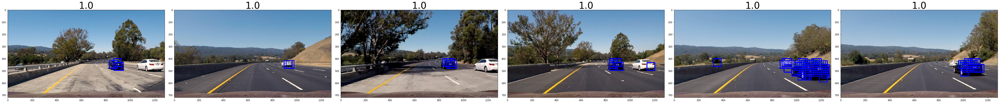

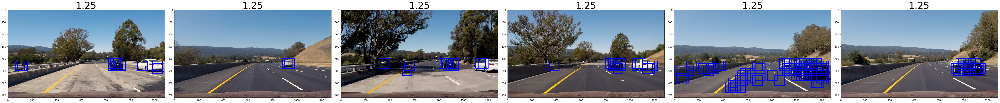

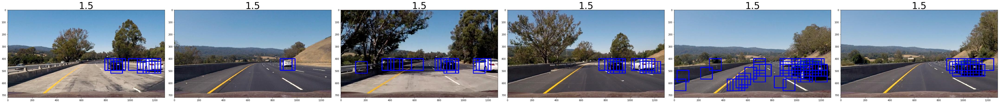

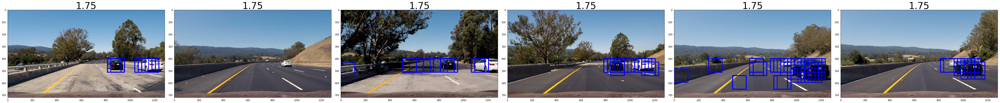

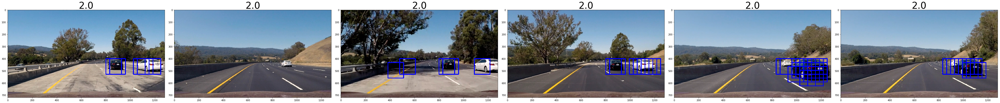

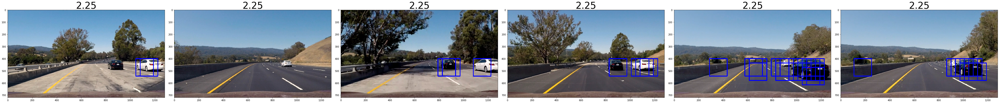

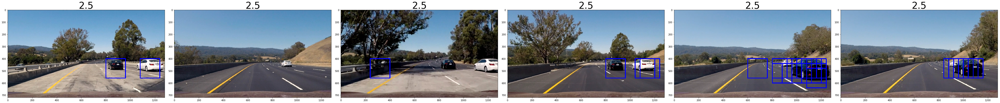

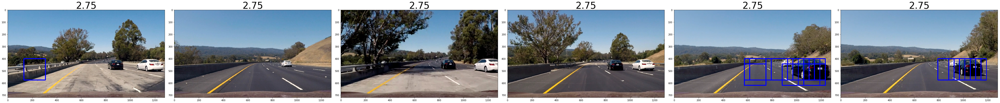

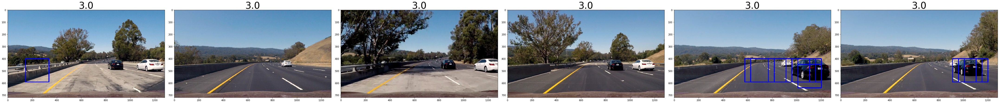

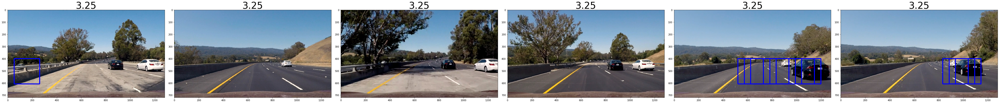

In [96]:
########################################################
# 5. IMAGE SUBSAMPLING and SEARCH
########################################################
def convert_color(img, conv='RGB2YCrCb'):
    if conv == 'RGB2YCrCb':
        return cv2.cvtColor(img, cv2.COLOR_RGB2YCrCb)
    if conv == 'BGR2YCrCb':
        return cv2.cvtColor(img, cv2.COLOR_BGR2YCrCb)
    if conv == 'RGB2LUV':
        return cv2.cvtColor(img, cv2.COLOR_RGB2LUV)
    
# Define a single function that can extract features using hog sub-sampling and make predictions
def find_cars(img, ystart=350, ystop=700, scale=1.0, svc=None, X_scaler=None, orient=9, pix_per_cell=8, cell_per_block=2, spatial_size=None, hist_bins=None, **kwargs ):
    #print('Using:', locals() )
    draw_img = np.copy(img)
    img = img.astype(np.float32)/255
    
    img_tosearch = img[ystart:ystop,:,:]
    ctrans_tosearch = convert_color(img_tosearch, conv='RGB2YCrCb')
    if scale != 1:
        imshape = ctrans_tosearch.shape
        ctrans_tosearch = cv2.resize(ctrans_tosearch, (np.int(imshape[1]/scale), np.int(imshape[0]/scale)))
        
    ch1 = ctrans_tosearch[:,:,0]
    ch2 = ctrans_tosearch[:,:,1]
    ch3 = ctrans_tosearch[:,:,2]

    # Define blocks and steps as above
    nxblocks = (ch1.shape[1] // pix_per_cell)-1
    nyblocks = (ch1.shape[0] // pix_per_cell)-1 
    nfeat_per_block = orient*cell_per_block**2
    # 64 was the orginal sampling rate, with 8 cells and 8 pix per cell
    window = 64
    nblocks_per_window = (window // pix_per_cell)-1 
    cells_per_step = 2  # Instead of overlap, define how many cells to step
    nxsteps = (nxblocks - nblocks_per_window) // cells_per_step
    nysteps = (nyblocks - nblocks_per_window) // cells_per_step
    
    # Compute individual channel HOG features for the entire image
    hog1 = get_hog_features(ch1, orient, pix_per_cell, cell_per_block, feature_vec=False)
    hog2 = get_hog_features(ch2, orient, pix_per_cell, cell_per_block, feature_vec=False)
    hog3 = get_hog_features(ch3, orient, pix_per_cell, cell_per_block, feature_vec=False)
    
    detections = []
    for xb in range(nxsteps):
        for yb in range(nysteps):
            ypos = yb*cells_per_step
            xpos = xb*cells_per_step
            # Extract HOG for this patch
            hog_feat1 = hog1[ypos:ypos+nblocks_per_window, xpos:xpos+nblocks_per_window].ravel() 
            hog_feat2 = hog2[ypos:ypos+nblocks_per_window, xpos:xpos+nblocks_per_window].ravel() 
            hog_feat3 = hog3[ypos:ypos+nblocks_per_window, xpos:xpos+nblocks_per_window].ravel() 
            hog_features = np.hstack((hog_feat1, hog_feat2, hog_feat3))

            xleft = xpos*pix_per_cell
            ytop = ypos*pix_per_cell

            # Extract the image patch
            subimg = cv2.resize(ctrans_tosearch[ytop:ytop+window, xleft:xleft+window], (64,64))
          
            # Get color features
            spatial_features = bin_spatial(subimg, size=spatial_size)
            hist_features = color_hist(subimg, nbins=hist_bins)

            # Scale features and make a prediction
            # The order of feature stacking here MUST match that of extract_block_features
            test_features = X_scaler.transform(np.hstack((spatial_features, hist_features, hog_features)).reshape(1, -1))    

            test_prediction = svc.predict(test_features)
            
            if test_prediction == 1:
                xbox_left = np.int(xleft*scale)
                ytop_draw = np.int(ytop*scale)
                win_draw = np.int(window*scale)
                cv2.rectangle(draw_img,(xbox_left, ytop_draw+ystart),(xbox_left+win_draw,ytop_draw+win_draw+ystart),(0,0,255),6) 
                detections.append(((xbox_left, ytop_draw+ystart),(xbox_left+win_draw,ytop_draw+win_draw+ystart)))
                
    return draw_img, detections
    
subsearch_pars = {
    'ystart' : 400,
    'ystop' : 700,
    'scale' : 1.5,
    'svc' : svc,
    'X_scaler' : X_scaler
}



for sc in np.arange(1,3.5,0.25):
    plts = []
    for imgfile in glob.glob('test_images/*.jpg'):
        img = mpimg.imread(imgfile)
        subsearch_pars['scale'] = sc
        out_img, detections = find_cars(img, **subsearch_pars, **feat_pars)
        plts.append({'img':out_img, 'title':sc})
    print("Scale: ", sc)
    plots(plts, colw=6)

In [123]:
########################################################
# 6. HEAT MAP CREATION
########################################################
from collections import deque
from scipy.ndimage.measurements import label


class HeatMap():
    def __init__(self):
        self.fbc = 10 #Frame Buffer Count. The amount of images we consider the heatmap on
        self.queue = deque([], self.fbc)
        self.heatmap = None #stores the heatmap
    
    # for every detections on every frame, return the labeled boxes
    def process_frame_detections(self, frame_size, detections_frame, heatmap_th=10):
        self.queue.append(detections_frame) #pop new detections into queue
        
        #flatten detections through fbc frames
        bbox_list = []
        for detections_frame in self.queue:
            for det in detections_frame:
                bbox_list.append(det)
        
        heat = np.zeros(frame_size).astype(np.float)
        # add heat
        self.heatmap = self.add_heat(heat, bbox_list)
        # Apply threshold to help remove false positives
        heat = self.apply_threshold(heat,heatmap_th)
        # Visualize the heatmap when displaying    
        self.heatmap = np.clip(heat, 0, 255)
        # Find final boxes from heatmap using label function
        labels = label(self.heatmap)
        
        return self._compute_labeled_bboxes(labels)
        
    def add_heat(self, heatmap, bbox_list):
        # Iterate through list of bboxes
        for box in bbox_list:
            # Add += 1 for all pixels inside each bbox
            # Assuming each "box" takes the form ((x1, y1), (x2, y2))
            heatmap[box[0][1]:box[1][1], box[0][0]:box[1][0]] += 1

        # Return updated heatmap
        return heatmap# Iterate through list of bboxes

    def apply_threshold(self, heatmap, threshold):
        # Zero out pixels below the threshold
        heatmap[heatmap <= threshold] = 0
        # Return thresholded map
        return heatmap

    def _compute_labeled_bboxes(self, labels):
        bbox_list = []
        # Iterate through all detected cars
        for car_number in range(1, labels[1]+1):
            # Find pixels with each car_number label value
            nonzero = (labels[0] == car_number).nonzero()
            # Identify x and y values of those pixels
            nonzeroy = np.array(nonzero[0])
            nonzerox = np.array(nonzero[1])
            # Define a bounding box based on min/max x and y
            bbox = ((np.min(nonzerox), np.min(nonzeroy)), (np.max(nonzerox), np.max(nonzeroy)))
            bbox_list.append(bbox)
        return bbox_list
    
    def draw_labeled_bboxes(self, img, bbox_list ):
        for bbox in bbox_list:
            cv2.rectangle(img, bbox[0], bbox[1], (0,0,255), 6)
        return img





In [128]:
########################################################
# 7. Moving Pipeline
########################################################
from enum import Enum

class Pipeline(): 
    def __init__(self):
        self.hm = HeatMap()
        
        self.subsearch_pars_list = [
            {
            'ystart' : 400,
            'ystop' : 500,
            'scale' : 1.0,
            'svc' : svc,
            'X_scaler' : X_scaler
            },
            {
            'ystart' : 400,
            'ystop' : 550,
            'scale' : 1.5,
            'svc' : svc,
            'X_scaler' : X_scaler
            },
            {
            'ystart' : 400,
            'ystop' : 575,
            'scale' : 2,
            'svc' : svc,
            'X_scaler' : X_scaler
            },
            {
            'ystart' : 400,
            'ystop' : 600,
            'scale' : 2.5,
            'svc' : svc,
            'X_scaler' : X_scaler
            },
            {
            'ystart' : 450,
            'ystop' : 656,
            'scale' : 3,
            'svc' : svc,
            'X_scaler' : X_scaler
            }
        ]
        
        self.mode = Pipeline.Modes.LABELED
    
    class Modes(Enum):
        BBOXES = 0
        HEATMAP = 1
        LABELED = 2
    
    def run(self, img):
        detections = []
        for spars in self.subsearch_pars_list:
            out_img, d = find_cars(img, **spars, **feat_pars)
            detections = detections + d
        

        if(self.mode == Pipeline.Modes.HEATMAP or self.mode == Pipeline.Modes.LABELED ):
            bbox_list = self.hm.process_frame_detections(img.shape[0:2] , detections)
            
            if(self.mode == Pipeline.Modes.HEATMAP):
                out_img = np.clip(np.asarray(np.dstack((self.hm.heatmap, self.hm.heatmap, self.hm.heatmap)))*10, 0, 255)

        if(self.mode == Pipeline.Modes.LABELED ):
            out_img = img.copy()
            self.hm.draw_labeled_bboxes(out_img, bbox_list)
        
        return out_img        

In [129]:
##################################################################
#   8. MOVIE CREATION
##################################################################
# Import everything needed to edit/save/watch video clips
from moviepy.editor import VideoFileClip
from IPython.display import HTML

def process_image(image):
    return p.run(image)

p = Pipeline()
output = 'output.mp4'
video_in = VideoFileClip("project_video.mp4", audio=False).subclip(0)
video_out = video_in.fl_image(process_image) #NOTE: this function expects color images!!
%time video_out.write_videofile(output, audio=False)

[MoviePy] >>>> Building video output.mp4
[MoviePy] Writing video output.mp4


100%|█████████▉| 1260/1261 [13:40<00:00,  1.61it/s]


[MoviePy] Done.
[MoviePy] >>>> Video ready: output.mp4 

CPU times: user 11min 45s, sys: 54.2 s, total: 12min 39s
Wall time: 13min 41s
